Використовуючи бібліотеку PyTorch, створіть генеративно - змагальну мережу (GAN) для генерації зображень  цифр MNIST.

1) Завантажте набір даних MNIST з використанням torchvision.datasets.
2) Створіть генератор, який приймає на вхід випадковий вектор з шумом та генерує зображення цифр MNIST.
3) Створіть дискримінатор, який приймає на вхід зображення цифр MNIST та визначає, чи є це реальне зображення чи згенероване генератором.
4) Обидві моделі повинні мати декілька шарів зі зменшенням розмірності зображення, використовуючи згортувальні та пулінгові шари. 
5) Навичіть моделі генерувати нові зображення цифр MNIST, використовуючи взаємодію генератора та дискримінатора з використанням функції втрат GAN (adversarial loss).
6) Після навчання, виведіть кілька згенерованих зображень та порівняйте їх з оригінальним зображенням з набору даних MNIST.

In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [9]:
image_size = 28          # розмір зображення

latent_size = 100        # розмір вектору шуму

batch_size = 128         # кількість зображень для навчання

num_epochs = 100         # кількість епох навчання

num_channels = 1

disc_hidden_size = 256   # кількість скритих нодів дискримінатора 

gen_hidden_size = 256    # кількість скритих нодів генератора

learning_rate = 0.0002   # коефіцієнт навчання

beta1 = 0.5              # коефіцієнти для функції втрат
beta2 = 0.999

In [6]:
# нормалізація зображень MNIST
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

# завантаження датасету MNIST
dataset = datasets.MNIST(root='./data', train=True, transform=transform, download=True)

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9912422/9912422 [00:25<00:00, 391064.27it/s]


Extracting ./data\MNIST\raw\train-images-idx3-ubyte.gz to ./data\MNIST\raw



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28881/28881 [00:00<00:00, 975076.42it/s]


Extracting ./data\MNIST\raw\train-labels-idx1-ubyte.gz to ./data\MNIST\raw



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1648877/1648877 [00:03<00:00, 429210.97it/s]


Extracting ./data\MNIST\raw\t10k-images-idx3-ubyte.gz to ./data\MNIST\raw



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4542/4542 [00:00<?, ?it/s]

Extracting ./data\MNIST\raw\t10k-labels-idx1-ubyte.gz to ./data\MNIST\raw



In [7]:
# Генератор
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.Linear(latent_size, gen_hidden_size),
            nn.ReLU(True),
            nn.Linear(gen_hidden_size, gen_hidden_size),
            nn.ReLU(True),
            nn.Linear(gen_hidden_size, image_size * image_size),
            nn.Tanh()
        )

    def forward(self, input):
        output = self.main(input)
        output = output.view(output.size(0), num_channels, image_size, image_size)
        return output


# Дискримінатор
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Linear(image_size * image_size, disc_hidden_size),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(disc_hidden_size, disc_hidden_size),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(disc_hidden_size, 1),
            nn.Sigmoid()
        )

    def forward(self, input):
        input = input.view(input.size(0), -1)
        output = self.main(input)
        return output

In [10]:
generator = Generator()
discriminator = Discriminator()

# створення оптимізаторів
optimizer_G = optim.Adam(generator.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(beta1, 0.999))

# функція втрат
criterion = nn.BCELoss()

In [16]:
img_list = []

# цикл навчання
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):

        # навчання на реальних зображеннях
        discriminator.zero_grad()
        real_images, _ = data
        batch_size = real_images.size(0)
        real_labels = torch.ones(batch_size, 1)
        real_output = discriminator(real_images)
        d_loss_real = criterion(real_output, real_labels)
        d_loss_real.backward()

        # навчання на згенерованих зображеннях
        noise = torch.randn(batch_size, latent_size)
        fake_images = generator(noise)
        fake_labels = torch.zeros(batch_size, 1)
        fake_output = discriminator(fake_images.detach())
        d_loss_fake = criterion(fake_output, fake_labels)
        d_loss_fake.backward()

        d_loss = d_loss_real + d_loss_fake
        optimizer_D.step()

        # навчання генератора
        generator.zero_grad()
        noise = torch.randn(batch_size, latent_size)
        fake_labels = torch.ones(batch_size, 1)
        fake_images = generator(noise)
        fake_output = discriminator(fake_images)
        g_loss = criterion(fake_output, fake_labels)
        g_loss.backward()


        optimizer_G.step()


        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     d_loss.item(), g_loss.item()))


    with torch.no_grad():
        fake_images = generator(noise).detach().cpu()
        img_list.append(vutils.make_grid(fake_images, padding=2, normalize=True))


    torch.save(generator.state_dict(), 'generator.pth')

[0/100][0/469]	Loss_D: 0.0681	Loss_G: 6.6078
[0/100][50/469]	Loss_D: 0.2992	Loss_G: 4.8578
[0/100][100/469]	Loss_D: 0.2102	Loss_G: 4.7827
[0/100][150/469]	Loss_D: 0.4142	Loss_G: 3.2910
[0/100][200/469]	Loss_D: 0.5189	Loss_G: 3.0871
[0/100][250/469]	Loss_D: 0.2651	Loss_G: 3.8035
[0/100][300/469]	Loss_D: 0.3541	Loss_G: 2.6475
[0/100][350/469]	Loss_D: 0.2972	Loss_G: 3.7920
[0/100][400/469]	Loss_D: 0.4446	Loss_G: 3.9535
[0/100][450/469]	Loss_D: 0.3412	Loss_G: 4.0054
[1/100][0/469]	Loss_D: 0.2189	Loss_G: 3.3063
[1/100][50/469]	Loss_D: 0.1891	Loss_G: 3.3969
[1/100][100/469]	Loss_D: 0.3583	Loss_G: 2.8023
[1/100][150/469]	Loss_D: 0.4402	Loss_G: 8.2745
[1/100][200/469]	Loss_D: 0.2922	Loss_G: 3.0537
[1/100][250/469]	Loss_D: 0.2297	Loss_G: 3.9969
[1/100][300/469]	Loss_D: 0.2597	Loss_G: 3.2558
[1/100][350/469]	Loss_D: 0.4692	Loss_G: 8.7749
[1/100][400/469]	Loss_D: 0.2100	Loss_G: 3.9083
[1/100][450/469]	Loss_D: 4.5291	Loss_G: 5.0614
[2/100][0/469]	Loss_D: 0.2757	Loss_G: 3.1556
[2/100][50/469]	Loss_

Animation size has reached 21124658 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


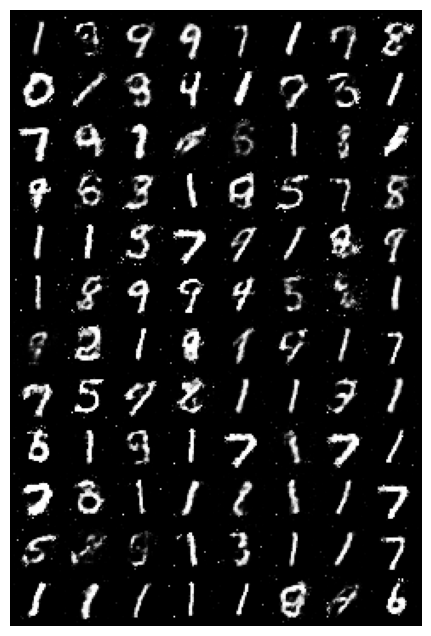

In [19]:
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

Порівнюючи результати, можна зробити висновок, що для даного завдання замало 100 епох (навчання зайняло близько години).